In [102]:
import librosa as lb
import librosa.display
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import IPython.display
%pylab inline
import plotly.graph_objects as go
from sklearn.cluster import KMeans

Populating the interactive namespace from numpy and matplotlib


/home/gato/anaconda3/lib/python3.9/site-packages/IPython/core/magics/pylab.py:159: UserWarning:

pylab import has clobbered these variables: ['trace']
`%matplotlib` prevents importing * from pylab and numpy



In [103]:
audio_data = 'bubu.wav'

In [104]:
IPython.display.Audio('bubu.wav')

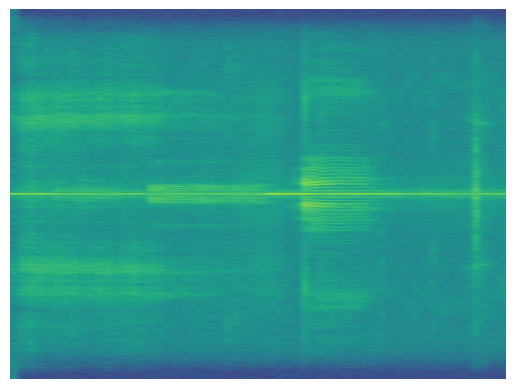

In [105]:
## Sound and Sample rate
y, sr = lb.load(audio_data, sr=44100, mono=True)
plt.specgram(y, NFFT=2048, Fs=2, Fc=0, noverlap=128, sides='twosided', mode='default', scale='dB')
plt.axis('off');
plt.savefig('bubu.jpg');

In [106]:
img2 = plt.imread('bubu.jpg')

In [107]:
# Reshape the image so that each row represents a single pixel 
# defined by three values: R, G, B
img_flat = img2.reshape(img2.shape[0]*img2.shape[1], 3)
img_flat[:5, :]

array([[255, 255, 255],
       [255, 255, 255],
       [255, 255, 255],
       [255, 255, 255],
       [255, 255, 255]], dtype=uint8)

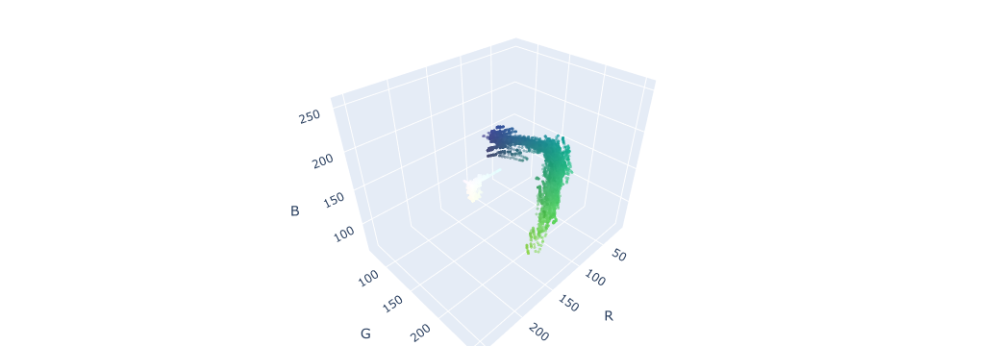

In [108]:
img_flat_df = pd.DataFrame(img_flat, columns = ['r', 'g', 'b'])
# Create 3D plot where each pixel in the `img` is displayed in its actual color
trace = go.Scatter3d(x = img_flat_df.r,
                     y = img_flat_df.g,
                     z = img_flat_df.b,
                     mode='markers',
                     marker=dict(size=1,
                                 color=['rgb({},{},{})'.format(r,g,b) for r,g,b 
                                        in zip(img_flat_df.r.values, 
                                               img_flat_df.g.values, 
                                               img_flat_df.b.values)],
                                 opacity=0.5))

data = [trace]

layout = go.Layout(margin=dict(l=0,
                               r=0,
                               b=0,
                               t=0),
                               )

fig = go.Figure(data=data, layout=layout)
fig.update_layout(scene = dict(
                    xaxis_title='R',
                    yaxis_title='G',
                    zaxis_title='B'),
                  )
fig.show()

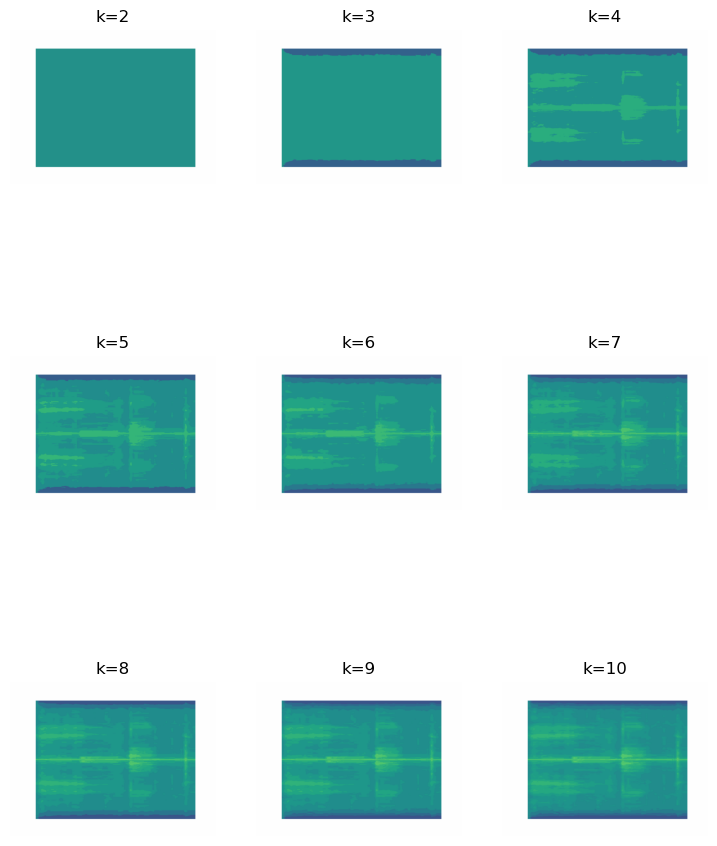

In [109]:
# Helper function to plot image grid
def cluster_image_grid(k, ax, img=img):
    '''
    Fits a K-means model to a photograph.
    Replaces photo's pixels with RGB values of model's centroids.
    Displays the updated image on an axis of a figure.

    Args:
      k:    (int)          - Your selected K-value
      ax:   (int)          - Index of the axis of the figure to plot to
      img:  (numpy array)  - Your original image converted to a numpy array

    Returns:
      A new image where each row of img's array has been replaced with the \ 
      coordinates of its nearest centroid. Image is assigned to an axis that \
      can be used in an image grid figure.
    '''
    img_flat = img.reshape(img.shape[0]*img.shape[1], 3)
    kmeans = KMeans(n_clusters=k, random_state=42).fit(img_flat)
    new_img = img_flat.copy()

    for i in np.unique(kmeans.labels_):
        new_img[kmeans.labels_==i, :] = kmeans.cluster_centers_[i]

    new_img = new_img.reshape(img.shape)
    ax.imshow(new_img)
    ax.axis('off')

fig, axs = plt.subplots(3, 3)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(9, 12)
axs = axs.flatten()
k_values = np.arange(2, 11)
for i, k in enumerate(k_values):
    cluster_image_grid(k, axs[i], img=img2)
    axs[i].title.set_text('k=' + str(k))